# about

evalutions of pseudobulk rna-seq samples

In [1]:
# gene quantification
ref_genome_tcga = "hg19"  # "hg19" or "hg38"
gene_units_tcga = "counts"  # "tpm" or "counts"
# data quality
mets_only_tcga = True
gene_sparsity_ceiling_tcga = 0.5
# pseudobulk generation parameters
n_cells_per_cell_type = 10
malignant_from_one_sample = True

In [2]:
import pathlib

base = pathlib.Path("figures-8a")
figure_path = base / ";".join(
    [f"ref_genome_tcga={ref_genome_tcga}", f"gene_units_tcga={gene_units_tcga}"]
)
figure_path.mkdir(parents=True, exist_ok=True)
figure_path

PosixPath('figures-8a/ref_genome_tcga=hg19;gene_units_tcga=counts')

# imports

In [3]:
import logging

import helpers
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
import plotly.io

In [4]:
handler = logging.StreamHandler()
formatter = logging.Formatter("%(asctime)s - %(name)s - %(levelname)s - %(message)s")
handler.setFormatter(formatter)
logging.getLogger().addHandler(handler)

In [5]:
logging.getLogger("gcsfs").setLevel("INFO")
logging.getLogger("google.cloud.bigquery").setLevel("DEBUG")
logging.getLogger("helpers").setLevel("DEBUG")
logging.getLogger("pandas").setLevel("DEBUG")
logging.getLogger("pyarrow").setLevel("DEBUG")

In [6]:
logger = logging.getLogger(__name__)
logger.setLevel("DEBUG")

In [7]:
rng = np.random.default_rng(seed=0)

# loading data

In [8]:
%%time
if ref_genome_tcga == "hg19" and gene_units_tcga == "tpm":
    bulk_tcga_skcm = helpers.datasets.load_tcga_skcm_hg19_scaled_estimate_firebrowse()
elif ref_genome_tcga == "hg19" and gene_units_tcga == "counts":
    bulk_tcga_skcm = (
        helpers.datasets.load_tcga_skcm_hg19_normalized_counts_dereks_file()
    )
elif ref_genome_tcga == "hg38" and gene_units_tcga == "tpm":
    bulk_tcga_skcm = helpers.datasets.load_tcga_skcm_hg38_fpkm_bigquery()
else:
    raise ValueError

2022-04-15 20:48:18,119 - helpers.datasets - DEBUG - reading gs://liulab/downloaded_manually/derek_csx_tcga_skcm/skcm_rnaseqv2_normalized_clean.txt


CPU times: user 1.72 s, sys: 258 ms, total: 1.98 s
Wall time: 3.17 s


In [9]:
bulk_tcga_skcm

sample_id,TCGA-3N-A9WB-06A-11R-A38C-07,TCGA-3N-A9WC-06A-11R-A38C-07,TCGA-3N-A9WD-06A-11R-A38C-07,TCGA-BF-A1PU-01A-11R-A18S-07,TCGA-BF-A1PV-01A-11R-A18U-07,TCGA-BF-A1PX-01A-12R-A18T-07,TCGA-BF-A1PZ-01A-11R-A18S-07,TCGA-BF-A1Q0-01A-21R-A18S-07,TCGA-BF-A3DJ-01A-11R-A20F-07,TCGA-BF-A3DL-01A-11R-A20F-07,...,TCGA-XV-AB01-06A-12R-A40A-07,TCGA-YD-A89C-06A-11R-A37K-07,TCGA-YD-A9TA-06A-11R-A39D-07,TCGA-YD-A9TB-06A-12R-A40A-07,TCGA-YG-AA3N-01A-11R-A38C-07,TCGA-YG-AA3O-06A-11R-A38C-07,TCGA-YG-AA3P-06A-11R-A38C-07,TCGA-Z2-A8RT-06A-11R-A37K-07,TCGA-Z2-AA3S-06A-11R-A39D-07,TCGA-Z2-AA3V-06A-11R-A39D-07
gene_symbol,,,,,,,,,,,,,,,,,,,,,
A1BG,381.0662,195.1822,360.8794,176.3994,216.8470,285.0608,424.5848,327.8758,232.2936,380.7694,...,428.9256,184.5297,88.4289,264.5184,238.8846,207.9831,33.5642,336.4070,349.4478,717.2209
A1CF,0.0000,0.0000,0.7092,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,1.3482,0.0000,0.0000,0.0000,0.0000,0.3876,0.0000,0.0000
A2BP1,0.0000,0.0000,6.3830,1.2987,0.0000,0.0000,0.0000,0.0000,0.0000,0.4901,...,0.0000,0.0000,0.0000,0.0000,0.5522,0.3380,66.0629,0.0000,0.2880,0.6539
A2LD1,250.1979,160.7548,97.1986,163.2338,60.8727,125.6900,78.8939,67.7049,92.9554,99.8579,...,47.5207,102.4404,36.9476,146.3544,88.2441,86.2831,50.0426,37.3178,152.9786,50.7438
A2M,2209.5194,169236.6356,18257.8865,6716.4513,1740.5828,32098.0014,3218.6418,6468.7807,377755.5402,7726.0377,...,17450.3581,20639.7659,12397.0606,25477.7594,10300.9056,37319.7533,8217.0591,22129.9496,4040.2938,46111.4664
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZYX,1236.2682,3594.4996,3270.2128,5132.1429,5128.2128,4675.7039,3177.7557,10974.0171,3042.2195,7198.7258,...,11526.1708,5296.0555,3701.5035,3021.2879,10181.1154,3125.3063,1925.4129,2865.1163,2136.9429,11832.5977
ZZEF1,622.7787,883.6696,1105.6738,1796.1039,1097.4298,1398.3316,1648.7663,1287.7062,1335.5161,1472.6783,...,1464.1873,852.6225,1245.0696,1078.7653,2362.7830,2671.3984,1480.5541,1849.6124,1640.4349,1413.1110
ZZZ3,721.3247,1137.8099,769.5035,286.0390,1658.9958,521.0288,651.4399,858.2361,962.2609,300.9066,...,224.5179,743.3897,958.9125,741.8840,1066.8139,940.5999,1003.7294,454.2636,1452.3724,102.0108


In [10]:
%%time
fractions_tcga_skcm = helpers.datasets.load_tcga_skcm_fractions_from_csx()

2022-04-15 20:48:21,397 - helpers.datasets - DEBUG - loading TCGA SKCM fractions estimated by CIBERSORTx


CPU times: user 14.8 ms, sys: 0 ns, total: 14.8 ms
Wall time: 59.3 ms


In [11]:
%%time
sc_jerby_arnon, sc_metadata_jerby_arnon = helpers.datasets.load_jerby_arnon_hg19_tpm()

2022-04-15 20:48:21,478 - helpers.datasets - DEBUG - loading Jerby-Arnon scRNA-seq data
2022-04-15 20:49:19,120 - helpers.datasets - DEBUG - loading Jerby-Arnon metadata


CPU times: user 1min, sys: 7.92 s, total: 1min 8s
Wall time: 57.7 s


In [12]:
# determine gene exclusions

exclusions_genes = pd.DataFrame(index=bulk_tcga_skcm.index.union(sc_jerby_arnon.index))

## sparsity in tcga
genes_sparse_tcga_skcm = bulk_tcga_skcm[
    (bulk_tcga_skcm == 0).mean(axis=1) > gene_sparsity_ceiling_tcga
].index
exclusions_genes["sparse_in_tcga_skcm"] = exclusions_genes.index.map(
    lambda g: g in genes_sparse_tcga_skcm
)

## genes not in both cohorts
genes_in_both = bulk_tcga_skcm.index.intersection(sc_jerby_arnon.index)
exclusions_genes["not_in_both_cohorts"] = exclusions_genes.index.map(
    lambda gene_name: gene_name not in genes_in_both
)

good_genes = exclusions_genes.loc[~exclusions_genes.any(axis=1)].index

https://console.cloud.google.com/bigquery?authuser=1&project=keen-dispatch-316219

In [13]:
# determine tcga sample exclusions

exclusions_tcga_samples = pd.DataFrame(index=bulk_tcga_skcm.columns)

## limit to metastases

if mets_only_tcga:
    query_text = """
        SELECT aliquot_barcode
        FROM `keen-dispatch-316219.gdc_tcga_skcm_subset.aliquot2caseIDmap_current`
        WHERE sample_type_name = 'Metastatic'
    """
    metastatic_aliquot_barcodes = pd.read_gbq(query_text)["aliquot_barcode"].values
    exclusions_tcga_samples["is_not_metastatic"] = exclusions_tcga_samples.index.map(
        lambda sample: sample not in metastatic_aliquot_barcodes
    )

good_tcga_samples = exclusions_tcga_samples.loc[
    ~exclusions_tcga_samples.any(axis=1)
].index

In [14]:
# apply exclusions

print(
    "before exclusions:",
    [df.shape for df in (sc_jerby_arnon, bulk_tcga_skcm, fractions_tcga_skcm)],
)
sc_jerby_arnon = sc_jerby_arnon.loc[good_genes]
bulk_tcga_skcm = bulk_tcga_skcm.loc[good_genes][good_tcga_samples]
fractions_tcga_skcm = fractions_tcga_skcm.loc[good_tcga_samples]
print(
    "after exclusions:",
    [df.shape for df in (sc_jerby_arnon, bulk_tcga_skcm, fractions_tcga_skcm)],
)

before exclusions: [(23686, 7186), (20531, 473), (473, 9)]
after exclusions: [(16002, 7186), (16002, 368), (368, 9)]


In [15]:
# convert to units per million

bulk_tcga_skcm *= 1_000_000 / bulk_tcga_skcm.sum()
sc_jerby_arnon *= 1_000_000 / sc_jerby_arnon.sum()

In [16]:
# compute pseudobulks and their cell type GEPs

bulk_pseudo, bulk_pseudo_cell_type_geps = helpers.creating_mixtures.make_mixtures(
    sc_jerby_arnon,
    sc_metadata_jerby_arnon,
    fractions_tcga_skcm.rename(index=lambda sample: f"pseudo_like_{sample}"),
    n_cells_per_gep=n_cells_per_cell_type,
    normalization_factor=1_000_000,
    malignant_from_one_sample=malignant_from_one_sample,
    rng=rng,
)

2022-04-15 20:49:21,544 - helpers.creating_mixtures - DEBUG - using np.random.Generator with BitGenerator state {'state': 35399562948360463058890781895381311971, 'inc': 87136372517582989555478159403783844777}
2022-04-15 20:49:21,548 - helpers.creating_mixtures - DEBUG - randomly chose Mel79 for malignant cells
2022-04-15 20:49:21,585 - helpers.creating_mixtures - DEBUG - randomly chose Mel82 for malignant cells
2022-04-15 20:49:21,619 - helpers.creating_mixtures - DEBUG - randomly chose Mel129pa for malignant cells
2022-04-15 20:49:21,654 - helpers.creating_mixtures - DEBUG - randomly chose Mel78 for malignant cells
2022-04-15 20:49:21,691 - helpers.creating_mixtures - DEBUG - randomly chose Mel112 for malignant cells
2022-04-15 20:49:21,725 - helpers.creating_mixtures - DEBUG - randomly chose Mel89 for malignant cells
2022-04-15 20:49:21,763 - helpers.creating_mixtures - DEBUG - randomly chose Mel102 for malignant cells
2022-04-15 20:49:21,799 - helpers.creating_mixtures - DEBUG - ran

# figures

## mean dists

In [17]:
bulk_all = pd.concat({"tcga skcm": bulk_tcga_skcm, "pseudobulk": bulk_pseudo}, axis=1)
dfg = bulk_all.stack().groupby("gene_symbol")
log_means = np.log10(dfg.aggregate("mean") + 1e-2)
log_stddevs = np.log10(dfg.aggregate("std") + 1e-2)

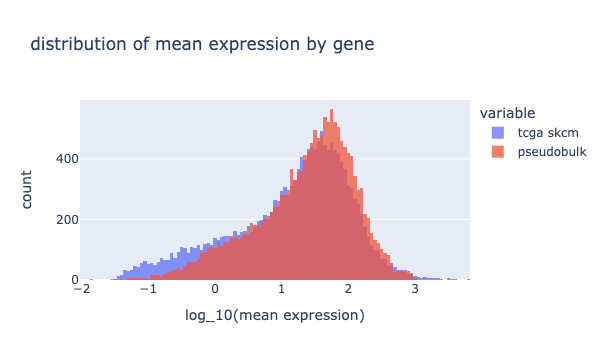

In [18]:
# df = pd.DataFrame({"tcga skcm": aggregate(bulk_tcga_skcm), "pseudobulks": aggregate(bulk_pseudo)})
title = "distribution of mean expression by gene"
x_axis_title = "log_10(mean expression)"
fig = px.histogram(log_means, title=title)
fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.75)
fig.update_xaxes(title=x_axis_title)

In [19]:
fig.write_image(figure_path / "mean_dist.png", width=800, height=500, scale=2)

### looking into very high expressed TCGA SKCM genes...

In [20]:
log_means.nlargest(10, columns=["tcga skcm"])

,tcga skcm,pseudobulk
gene_symbol,,
ACTB,3.803240,2.960054
GAPDH,3.798843,3.012143
VIM,3.740842,2.911907
ACTG1,3.721139,2.928566
EEF1A1,3.590582,2.976700
FTL,3.586230,2.976071
EEF2,3.573529,2.720465
CD74,3.551762,2.436886
FN1,3.525877,2.197710


## stddev dists

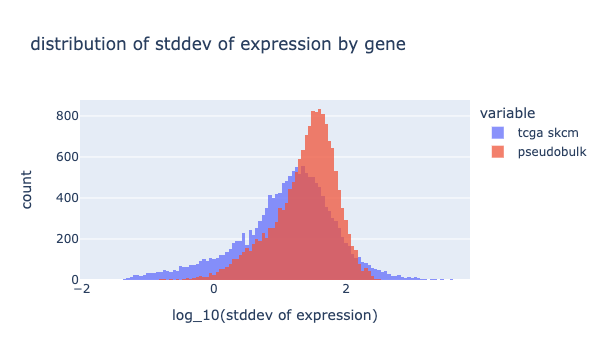

In [21]:
# df = pd.DataFrame({"tcga skcm": aggregate(bulk_tcga_skcm), "pseudobulks": aggregate(bulk_pseudo)})
title = "distribution of stddev of expression by gene"
x_axis_title = "log_10(stddev of expression)"
fig = px.histogram(log_stddevs, title=title)
fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.75)
fig.update_xaxes(title=x_axis_title)

In [22]:
fig.write_image(figure_path / "stddev_dist.png", width=800, height=500, scale=2)

## mean jointdist scatter

/opt/conda/envs/deconv/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning:

divide by zero encountered in log10

/opt/conda/envs/deconv/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:1652: RuntimeWarning:

invalid value encountered in subtract

/opt/conda/envs/deconv/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:1687: RuntimeWarning:

invalid value encountered in subtract



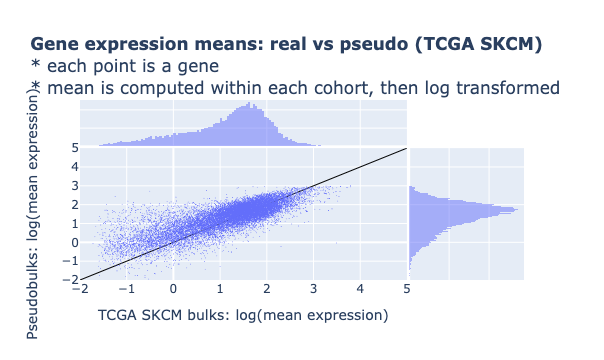

In [23]:
title = (
    "<b>Gene expression means: real vs pseudo (TCGA SKCM)</b>"
    "<br>* each point is a gene"
    "<br>* mean is computed within each cohort, then log transformed"
)
label_real, label_pseudo = "TCGA SKCM bulks", "pseudobulks"
axis_range = [-2, 5]

df = pd.DataFrame(
    {
        label_real: np.log10(bulk_tcga_skcm.mean(axis=1)),
        f"{label_real} sparsity": (bulk_tcga_skcm == 0).mean(axis=1),
        label_pseudo: np.log10(bulk_pseudo.mean(axis=1)),
        f"{label_pseudo} sparsity": (bulk_pseudo == 0).mean(axis=1),
    },
)

fig = px.scatter(
    df,
    x=label_real,
    y=label_pseudo,
    title=title,
    marginal_x="histogram",
    marginal_y="histogram",
    hover_name=df.index,
    hover_data=df.columns,
    trendline="ols",
)
fig.add_trace(
    go.Scatter(
        x=axis_range,
        y=axis_range,
        marker=dict(color="black"),
        line=dict(width=1),
        showlegend=False,
        mode="lines",
    ),
    row=1,
    col=1,
)
fig.update_traces(marker=dict(size=1), row=1, col=1)
fig.update_xaxes(
    title="TCGA SKCM bulks: log(mean expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=axis_range,
)
fig.update_yaxes(
    title="Pseudobulks: log(mean expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=axis_range,
)
# fig.show(height=800)

In [24]:
fig.write_image(
    figure_path / "mean_jointdist_scatter.png", width=800, height=700, scale=2
)

## stddev jointdist scatter

/opt/conda/envs/deconv/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning:

divide by zero encountered in log10

/opt/conda/envs/deconv/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:1652: RuntimeWarning:

invalid value encountered in subtract

/opt/conda/envs/deconv/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:1687: RuntimeWarning:

invalid value encountered in subtract



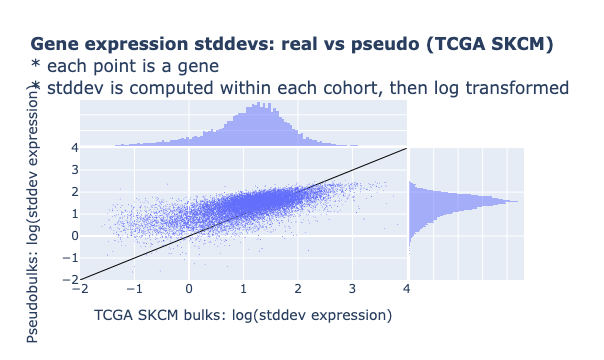

In [25]:
title = (
    "<b>Gene expression stddevs: real vs pseudo (TCGA SKCM)</b>"
    "<br>* each point is a gene"
    "<br>* stddev is computed within each cohort, then log transformed"
)
label_real, label_pseudo = "TCGA SKCM bulks", "pseudobulks"
axis_range = [-2, 4]

df = pd.DataFrame(
    {
        label_real: np.log10(bulk_tcga_skcm.std(axis=1)),
        f"{label_real} sparsity": (bulk_tcga_skcm == 0).mean(axis=1),
        label_pseudo: np.log10(bulk_pseudo.std(axis=1)),
        f"{label_pseudo} sparsity": (bulk_pseudo == 0).mean(axis=1),
    },
)

fig = px.scatter(
    df,
    x=label_real,
    y=label_pseudo,
    title=title,
    marginal_x="histogram",
    marginal_y="histogram",
    hover_name=df.index,
    hover_data=df.columns,
    trendline="ols",
)
fig.add_trace(
    go.Scatter(
        x=axis_range,
        y=axis_range,
        marker=dict(color="black"),
        line=dict(width=1),
        showlegend=False,
        mode="lines",
    ),
    row=1,
    col=1,
)
fig.update_traces(marker=dict(size=1), row=1, col=1)
fig.update_xaxes(
    title="TCGA SKCM bulks: log(stddev expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=axis_range,
)
fig.update_yaxes(
    title="Pseudobulks: log(stddev expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=axis_range,
)
fig.show(height=800)

In [26]:
fig.write_image(
    figure_path / "stddev_jointdist_scatter.png", width=800, height=700, scale=2
)

## PCA

In [27]:
all_bulks = pd.concat(
    {"tcga skcm": bulk_tcga_skcm, "pseudobulks": bulk_pseudo},
    axis=1,
    names=["sample_origin", helpers.columns.SAMPLE_ID],
).T

In [28]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(all_bulks)
all_bulks.values[:] = scaler.transform(all_bulks)

all_bulks.iloc[:, :5].agg(["mean", "std"])

gene_symbol,A1BG,A2M,A2ML1,A4GALT,A4GNT
mean,7.723291e-17,-1.930823e-16,-2.606611e-16,2.268717e-16,1.930823e-17
std,1.000680e+00,1.000680e+00,1.000680e+00,1.000680e+00,1.000680e+00


In [29]:
from sklearn.decomposition import PCA

n_components = 10

pca = PCA(n_components=n_components)
pca.fit(all_bulks)
pca_gene_eigenvectors = (
    pd.DataFrame(
        pca.components_,
        columns=all_bulks.columns,
        index=["PC " + str(i + 1) for i in range(n_components)],
    )
    .rename_axis(index="PCs")
    .T
)
pca_plot_axis_labels = {
    str(i): f"PC {i+1}<br>({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}

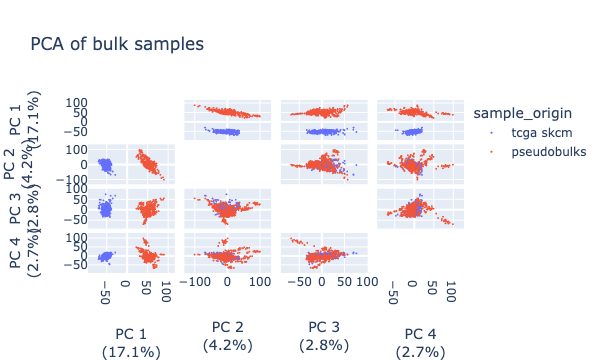

In [30]:
pca_coefficients_all_bulks = pd.DataFrame(
    pca.transform(all_bulks), index=all_bulks.index
).reset_index()

fig = px.scatter_matrix(
    pca_coefficients_all_bulks,
    labels=pca_plot_axis_labels,
    dimensions=range(4),
    color="sample_origin",
    hover_name=helpers.columns.SAMPLE_ID,
    title="PCA of bulk samples",
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.show(height=800)
fig.update_layout({f"xaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.update_layout({f"yaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.write_image(figure_path / "pca_4_samples.png", width=800, height=700, scale=2)

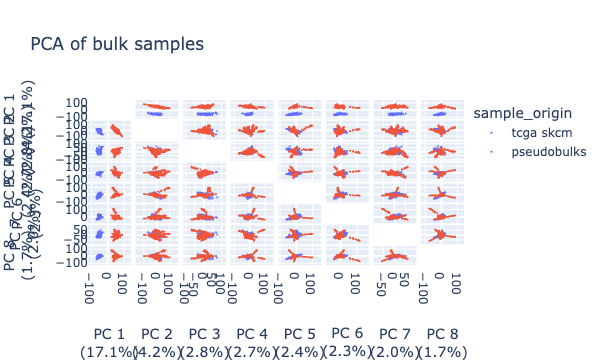

In [31]:
fig = px.scatter_matrix(
    pca_coefficients_all_bulks,
    labels=pca_plot_axis_labels,
    dimensions=range(8),
    color="sample_origin",
    hover_name=helpers.columns.SAMPLE_ID,
    title="PCA of bulk samples",
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.show(height=800)
fig.update_layout({f"xaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.update_layout({f"yaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.write_image(figure_path / "pca_8_samples.png", width=800, height=700, scale=2)

### applied to pseudobulk cell type GEPs

In [32]:
pseudo_cell_type_geps = pd.concat(
    bulk_pseudo_cell_type_geps,
    axis=1,
    names=[helpers.columns.SAMPLE_ID, helpers.columns.CELL_TYPE],
).T
pseudo_cell_type_geps.values[:] = scaler.transform(pseudo_cell_type_geps)
pseudo_cell_type_geps.iloc[:, :5].agg(["mean", "std"])

gene_symbol,A1BG,A2M,A2ML1,A4GALT,A4GNT
mean,-0.226938,-0.436507,0.625257,0.868262,0.291398
std,1.029340,0.081442,0.742018,3.359996,2.577402


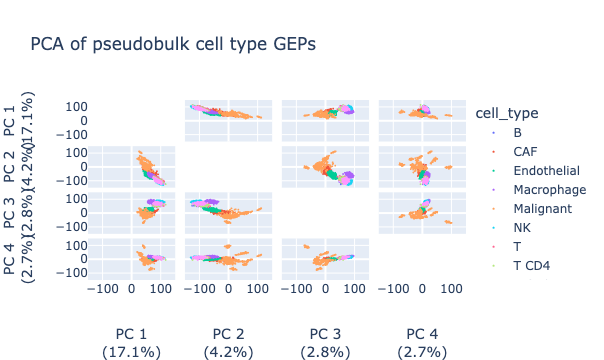

In [33]:
pca_coefficients_pseudo_cell_type_geps = pd.DataFrame(
    pca.transform(pseudo_cell_type_geps), index=pseudo_cell_type_geps.index
).reset_index()

fig = px.scatter_matrix(
    pca_coefficients_pseudo_cell_type_geps,
    labels=pca_plot_axis_labels,
    dimensions=range(4),
    color=helpers.columns.CELL_TYPE,
    hover_name=helpers.columns.SAMPLE_ID,
    title="PCA of pseudobulk cell type GEPs",
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.update_layout({f"xaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.update_layout({f"yaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.show(height=800)
fig.write_image(
    figure_path / "pca_4_pseudo_cell_type_geps.png", width=800, height=700, scale=2
)

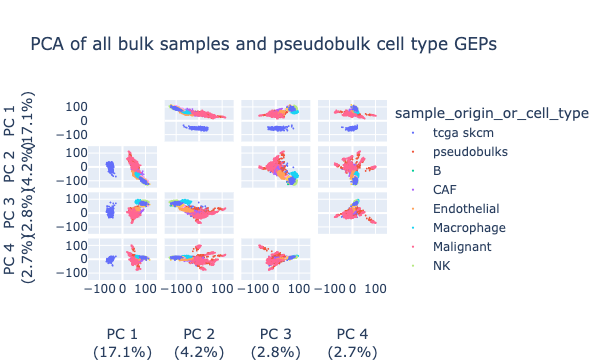

In [34]:
pca_coefficients_bulks_and_geps = pd.concat(
    [pca_coefficients_all_bulks, pca_coefficients_pseudo_cell_type_geps]
)
pca_coefficients_bulks_and_geps[
    "sample_origin_or_cell_type"
] = pca_coefficients_bulks_and_geps["sample_origin"].fillna(
    pca_coefficients_bulks_and_geps["cell_type"]
)

fig = px.scatter_matrix(
    pca_coefficients_bulks_and_geps,
    labels=pca_plot_axis_labels,
    dimensions=range(4),
    color="sample_origin_or_cell_type",
    hover_name=helpers.columns.SAMPLE_ID,
    title="PCA of all bulk samples and pseudobulk cell type GEPs",
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.update_layout({f"xaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.update_layout({f"yaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.write_image(
    figure_path / "pca_4_bulks_and_geps.png", width=800, height=700, scale=2
)
fig.show(height=1000, width=800)

### first PC

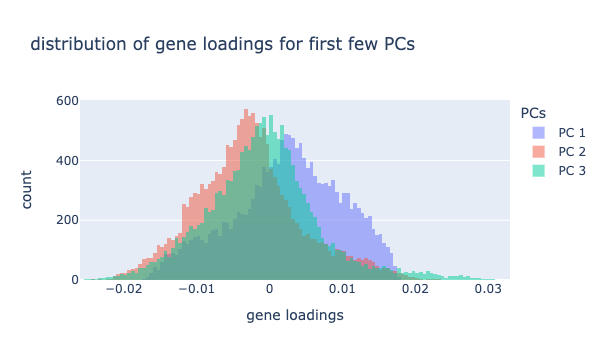

In [35]:
title = "distribution of gene loadings for first few PCs"
fig = px.histogram(pca_gene_eigenvectors.iloc[:, :3], title=title)
fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.5)
fig.update_xaxes(title="gene loadings")

In [36]:
gene_features = pca_gene_eigenvectors.iloc[:, :3]
gene_features["sparse_rate_bulk_tcga_skcm"] = (bulk_tcga_skcm == 0).mean(axis=1)
gene_features["sparse_rate_sc_jerby_arnon"] = (sc_jerby_arnon == 0).mean(axis=1)
gene_features["mean_bulk_tcga_skcm"] = bulk_tcga_skcm.mean(axis=1)
gene_features["stddev_bulk_tcga_skcm"] = bulk_tcga_skcm.std(axis=1)
gene_features["mean_sc_jerby_arnon"] = sc_jerby_arnon.mean(axis=1)
gene_features["stddev_sc_jerby_arnon"] = sc_jerby_arnon.std(axis=1)

In [37]:
gene_features.corr(
    # method="spearman"
)

PCs,PC 1,PC 2,PC 3,sparse_rate_bulk_tcga_skcm,sparse_rate_sc_jerby_arnon,mean_bulk_tcga_skcm,stddev_bulk_tcga_skcm,mean_sc_jerby_arnon,stddev_sc_jerby_arnon
PCs,,,,,,,,,
PC 1,1.000000,0.129321,0.036867,0.054819,-0.316398,-0.258590,-0.209492,0.203849,0.264710
PC 2,0.129321,1.000000,-0.043326,0.013724,0.081252,0.128201,0.079783,0.190427,0.192030
PC 3,0.036867,-0.043326,1.000000,0.083643,0.011643,0.024751,0.050505,0.123789,0.105779
sparse_rate_bulk_tcga_skcm,0.054819,0.013724,0.083643,1.000000,0.243454,-0.119925,-0.077472,-0.201327,-0.359563
sparse_rate_sc_jerby_arnon,-0.316398,0.081252,0.011643,0.243454,1.000000,-0.290723,-0.152232,-0.691246,-0.614294
mean_bulk_tcga_skcm,-0.258590,0.128201,0.024751,-0.119925,-0.290723,1.000000,0.815761,0.542133,0.392325
stddev_bulk_tcga_skcm,-0.209492,0.079783,0.050505,-0.077472,-0.152232,0.815761,1.000000,0.326637,0.245058
mean_sc_jerby_arnon,0.203849,0.190427,0.123789,-0.201327,-0.691246,0.542133,0.326637,1.000000,0.817379
stddev_sc_jerby_arnon,0.264710,0.192030,0.105779,-0.359563,-0.614294,0.392325,0.245058,0.817379,1.000000


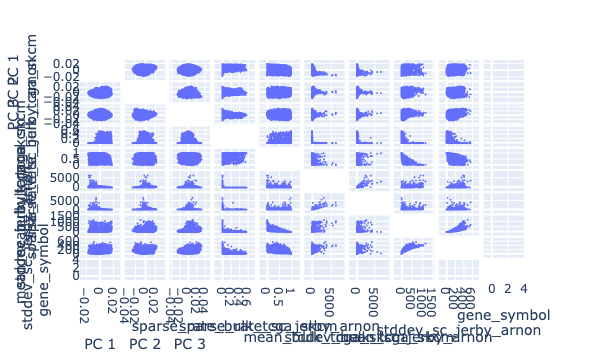

In [38]:
fig = px.scatter_matrix(gene_features, hover_name=gene_features.index)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.show(height=800)
fig.write_image(
    figure_path / "gene_features_scatter_matrix.png", width=800, height=700, scale=2
)

In [39]:
gene_features.sort_values(by="PC 1", ascending=False)

PCs,PC 1,PC 2,PC 3,sparse_rate_bulk_tcga_skcm,sparse_rate_sc_jerby_arnon,mean_bulk_tcga_skcm,stddev_bulk_tcga_skcm,mean_sc_jerby_arnon,stddev_sc_jerby_arnon
gene_symbol,,,,,,,,,
ASTN2,0.018142,-0.004893,-0.000049,0.000000,0.010854,14.004084,31.581270,544.542633,271.130792
ODF2L,0.017872,-0.007486,0.000008,0.000000,0.014194,18.644176,12.205639,409.221729,214.412519
SHISA9,0.017806,-0.007944,-0.000771,0.331522,0.014055,1.140095,8.078528,425.118036,229.261234
SPC25,0.017764,-0.008573,-0.001069,0.000000,0.061926,7.928009,5.329303,381.909527,226.085511
CFLAR,0.017708,-0.005927,0.004431,0.000000,0.005288,36.664371,18.497097,394.822480,218.355541
...,...,...,...,...,...,...,...,...,...
SETD1A,-0.016969,-0.003577,0.002352,0.000000,0.915391,67.238107,21.107320,9.532404,50.320406
U2AF2,-0.016969,-0.001973,0.001597,0.000000,0.812970,218.919438,67.314962,21.065251,70.208581
CHMP4B,-0.017118,-0.002353,0.004934,0.000000,0.949068,165.747150,47.199926,9.767632,59.857577


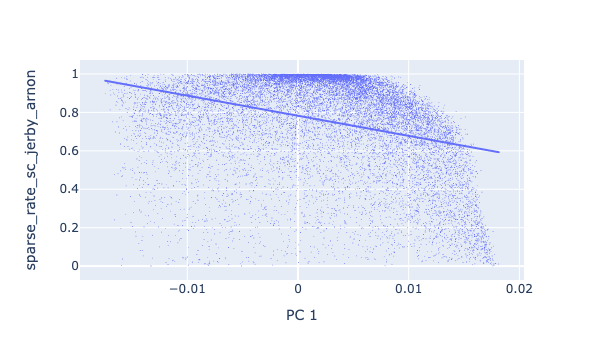

In [40]:
fig = px.scatter(
    gene_features,
    x="PC 1",
    y="sparse_rate_sc_jerby_arnon",
    trendline="ols",
)
fig.update_traces(marker=dict(size=1))

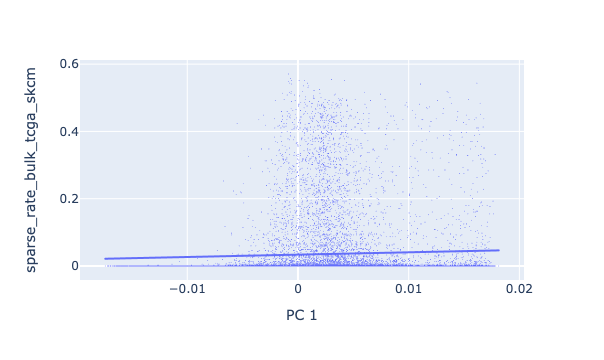

In [41]:
fig = px.scatter(
    gene_features,
    x="PC 1",
    y="sparse_rate_bulk_tcga_skcm",
    trendline="ols",
)
fig.update_traces(marker=dict(size=1))

In [42]:
pca_gene_eigenvectors["PC 1"].nlargest(10)

gene_symbol
ASTN2        0.018142
ODF2L        0.017872
SHISA9       0.017806
SPC25        0.017764
CFLAR        0.017708
PGM5P2       0.017680
LOC646214    0.017638
NEK5         0.017623
TRAPPC2      0.017614
KCNQ1OT1     0.017606
Name: PC 1, dtype: float64

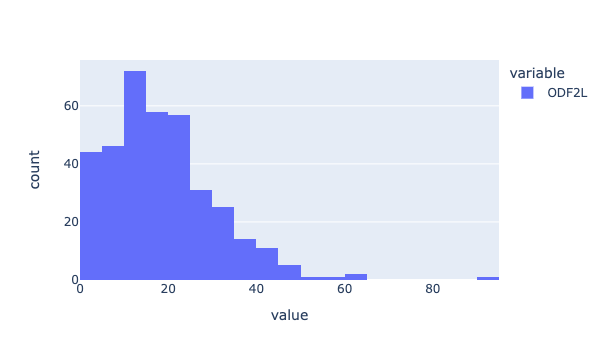

In [43]:
px.histogram(bulk_tcga_skcm.loc["ODF2L"])

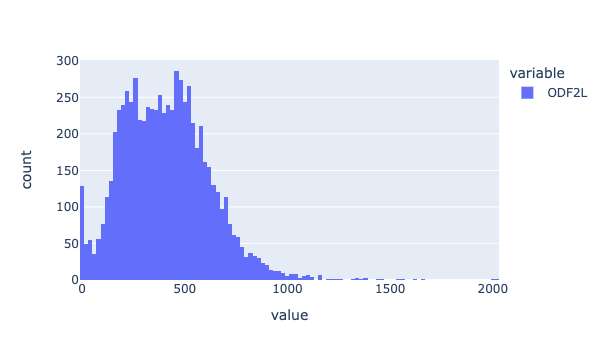

In [44]:
px.histogram(sc_jerby_arnon.loc["ODF2L"])